# Состав команды

1. [Антон Нестеренко](https://data.vk.company/profile/a.nesterenko/), MADE-ML-32
2. [Анастасия Новикова](https://data.vk.company/profile/ana.novikova/), MADE-ML-31
3. [Владимир Королихин](https://data.vk.company/profile/v.korolikhin/), MADE-ML-12
4. [Гаджимурад Абдуллаев](https://data.vk.company/profile/g.abdullaev/), MADE-DS-12
5. [Дмитрий Астанков](https://data.vk.company/profile/d.astankov/), MADE-DS-32
6. [Ирина Щетинина](https://data.vk.company/profile/i.shchetinina/), MADE-DS-32
7. [Руслан Ахмеров](https://data.vk.company/profile/r.akhmerov/), MADE-DS-32

# Библиотеки

In [ ]:
#@title Установка пакетов {display-mode: "form"}
!pip install -q dowhy
!apt install -q libgraphviz-dev
!pip install -q pygraphviz
!pip install -q shap
!pip install -q lime
!pip install -q -U scikit-learn

     |████████████████████████████████| 123 kB 5.3 MB/s 
Reading package lists...
Building dependency tree...
Reading state information...
The following additional packages will be installed:
  libgail-common libgail18 libgtk2.0-0 libgtk2.0-bin libgtk2.0-common
  libgvc6-plugins-gtk libxdot4
Suggested packages:
  gvfs
The following NEW packages will be installed:
  libgail-common libgail18 libgraphviz-dev libgtk2.0-0 libgtk2.0-bin
  libgtk2.0-common libgvc6-plugins-gtk libxdot4
0 upgraded, 8 newly installed, 0 to remove and 37 not upgraded.
Need to get 2,120 kB of archives.
After this operation, 7,128 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/main amd64 libgtk2.0-common all 2.24.32-1ubuntu1 [125 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/main amd64 libgtk2.0-0 amd64 2.24.32-1ubuntu1 [1,769 kB]
Get:3 http://archive.ubuntu.com/ubuntu bionic/main amd64 libgail18 amd64 2.24.32-1ubuntu1 [14.2 kB]
Get:4 http://archive.ubuntu.com/ubuntu bio

In [ ]:
#@title Импорты {display-mode: "form"}
import datetime
import os
import sys
import logging.config
import warnings

import dowhy
import dowhy.datasets
import lime
import lime.lime_tabular
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pygraphviz
import seaborn as sns
import shap
import statsmodels
from IPython.display import Image, display
from dowhy import CausalModel
from google.colab import drive
from lime import submodular_pick
from sklearn.exceptions import DataConversionWarning, ConvergenceWarning
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.model_selection import GridSearchCV, StratifiedKFold, train_test_split
from sklearn.neural_network import MLPClassifier
from sklearn.preprocessing import StandardScaler
from xgboost.sklearn import XGBClassifier

In [ ]:
#@title Настройка логгирования {display-mode: "form"}
DEFAULT_LOGGING = {
    "version": 1,
    "disable_existing_loggers": False,
    "loggers": {
        "": {
            "level": "INFO",
        },
    },
}

logging.config.dictConfig(DEFAULT_LOGGING)

warnings.filterwarnings(action="ignore", category=DataConversionWarning)
warnings.filterwarnings(action="ignore", category=ConvergenceWarning)
warnings.filterwarnings(action="ignore", category=UserWarning)
warnings.filterwarnings(action="ignore", category=FutureWarning)

# Данные

**Датасет**: <a href="https://www.kaggle.com/sourabhsabharwal/mobile-company-customers-retention">Mobile Company Customers Retention</a>.

**Задача**: прогнозирование оттока клиентов компании-оператора мобильной связи (бинарная классификация).

Загрузим данные с Гугл-диска (были предварительно загружены туда, чтобы не использовать Kaggle API в ноутбуке):

In [ ]:
!gdown --id 1Am6iWQguC2iP9mt_LFfxhb-7QvKE3P0x

Downloading...
From: https://drive.google.com/uc?id=1Am6iWQguC2iP9mt_LFfxhb-7QvKE3P0x
To: /content/Cellphone.csv
100% 129k/129k [00:00<00:00, 47.3MB/s]


In [ ]:
df = pd.read_csv("Cellphone.csv")
df.head()

,Churn,AccountWeeks,ContractRenewal,DataPlan,DataUsage,CustServCalls,DayMins,DayCalls,MonthlyCharge,OverageFee,RoamMins
0,0,128,1,1,2.7,1,265.1,110,89.0,9.87,10.0
1,0,107,1,1,3.7,1,161.6,123,82.0,9.78,13.7
2,0,137,1,0,0.0,0,243.4,114,52.0,6.06,12.2
3,0,84,0,0,0.0,2,299.4,71,57.0,3.10,6.6
4,0,75,0,0,0.0,3,166.7,113,41.0,7.42,10.1


In [ ]:
df.nunique()

Churn                 2
AccountWeeks        212
ContractRenewal       2
DataPlan              2
DataUsage           174
CustServCalls        10
DayMins            1667
DayCalls            119
MonthlyCharge       627
OverageFee         1024
RoamMins            162
dtype: int64

In [ ]:
REAL_COLS = [
    "AccountWeeks",
    "DataUsage",
    "CustServCalls",
    "DayMins",
    "DayCalls",
    "MonthlyCharge",
    "OverageFee",
    "RoamMins",
]

In [ ]:
TARGET_COL = "Churn"

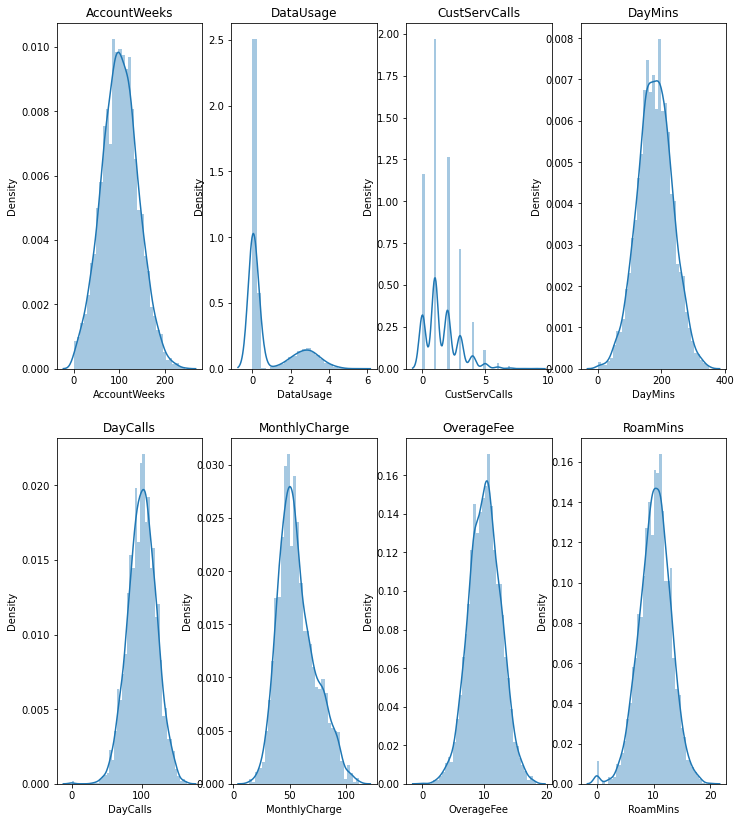

In [ ]:
fig, ax = plt.subplots(2, 4)
fig.set_figheight(14)
fig.set_figwidth(12)
for i, col in enumerate(REAL_COLS):
    row_id = i // 4
    col_id = i % 4
    ax[row_id, col_id].set_title(col)
    sns.distplot(df[col], ax=ax[row_id, col_id]);

In [ ]:
df["NoDataUsage"] = (df["DataUsage"] == 0).astype(np.uint8)
df["NoRoamMins"] = (df["RoamMins"] == 0).astype(np.uint8)

In [ ]:
CAT_COLS = ["ContractRenewal", "DataPlan", "NoDataUsage", "NoRoamMins"]

# 1 Поиск причинно-следственных связей

## 1.1 Исследование зависимости количества звонков в службу поддержки на отток
(используем linear regression для оценки эффекта, проверка refutation проходит корректно)

Рассмотрим графовую модель, используемую по умолчанию: все признаки влияют на количество звонков в службу поддержки и все признаки влияют на отток.

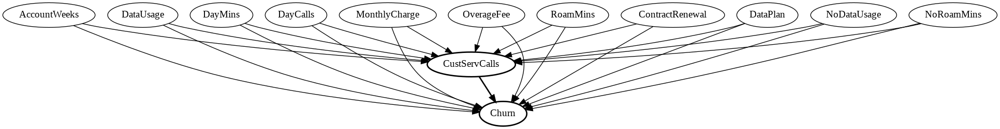

In [ ]:
#@title Графовая модель по умолчанию {display-mode: "form"}
treatment_col = "CustServCalls"

standart_model = CausalModel(
    data=df,
    treatment=treatment_col,
    outcome=TARGET_COL,
    common_causes=[c for c in REAL_COLS + CAT_COLS if c not in (treatment_col, TARGET_COL)],
)

standart_model.view_model()
display(Image(filename="causal_model.png"))

Выполним идентификацию. Найдём все возможные способы определения причинно-следственного эффекта на основе графической модели.
При таком построении модели через каждую из вершин графа, кроме целевых, проходит backdoor-путь. Соответственно, множество Z, найденное по backdoor-критерию, содержит в себе все вершины графа.

In [ ]:
standart_identified_estimand = standart_model.identify_effect(
    proceed_when_unidentifiable=True
)
print(standart_identified_estimand)

Estimand type: nonparametric-ate

### Estimand : 1
Estimand name: backdoor
Estimand expression:
       d                                                                      
────────────────(Expectation(Churn|OverageFee,NoRoamMins,DataUsage,RoamMins,Mo
d[CustServCalls]                                                              

                                                                              
nthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,ContractRenewal,DayMins
                                                                              

  
))
  
Estimand assumption 1, Unconfoundedness: If U→{CustServCalls} and U→Churn then P(Churn|CustServCalls,OverageFee,NoRoamMins,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,ContractRenewal,DayMins,U) = P(Churn|CustServCalls,OverageFee,NoRoamMins,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,ContractRenewal,DayMins)

### Estimand : 2
Estimand name: iv
No such va

Оценим причинно-следственную связь. <br>
Используем метод оценки эффекта, базирующийся на оценке выхода модели (так как наш treatment не является бинарным).

Получили незначительный положительный эффект (0.0583).

In [ ]:
standart_estimate = standart_model.estimate_effect(
    standart_identified_estimand,
    method_name="backdoor.linear_regression",
    target_units="ate",
)

print(standart_estimate)

*** Causal Estimate ***

## Identified estimand
Estimand type: nonparametric-ate

### Estimand : 1
Estimand name: backdoor
Estimand expression:
       d                                                                      
────────────────(Expectation(Churn|OverageFee,NoRoamMins,DataUsage,RoamMins,Mo
d[CustServCalls]                                                              

                                                                              
nthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,ContractRenewal,DayMins
                                                                              

  
))
  
Estimand assumption 1, Unconfoundedness: If U→{CustServCalls} and U→Churn then P(Churn|CustServCalls,OverageFee,NoRoamMins,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,ContractRenewal,DayMins,U) = P(Churn|CustServCalls,OverageFee,NoRoamMins,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,ContractRenewal,DayMins

Сделаем несколько предположений и построим на их основе графовую модель.

Предположения:
* наличие или отсутствие выделенного тарифного плана влияет на количество звонков (которое в свою очередь влияет на количество потраченных минут) и объём трафика;
* количество минут в роуминге зависит от тарифного плана и общего количества минут;
* количество недель контракта зависит от того, был ли он возобновлён;
* звонки в службу поддержки совершаются в том числе при переплате;
* на отток влияет: длительность сотрудничества клиента и оператора, использует ли клиент он трафик и роуминг, месячные платежи и обращения клиента в службу поддержки.

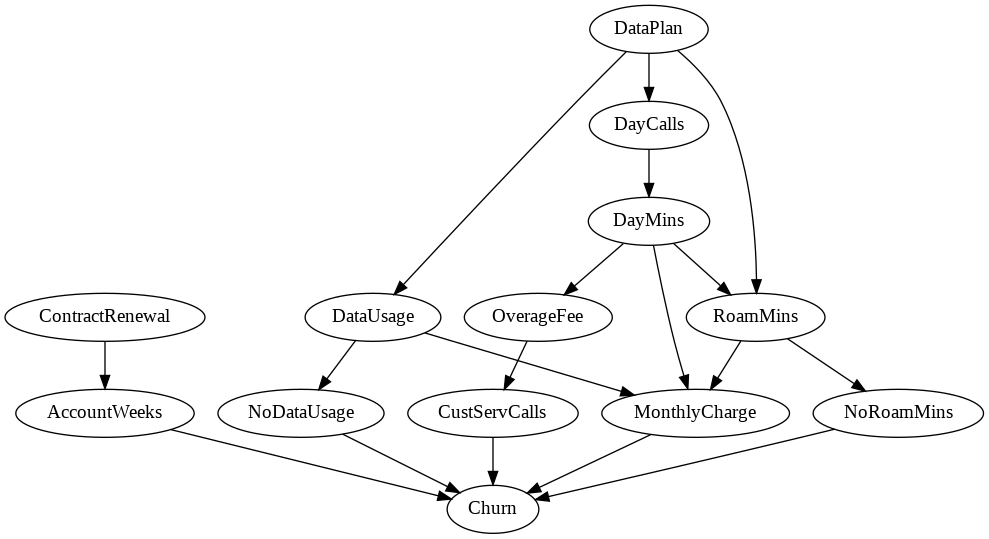

In [ ]:
#@title Графовая модель на основании наших предположения {display-mode: "form"}
causal_graph = """digraph {
Churn[label="Churn"];
AccountWeeks[label="AccountWeeks"];
ContractRenewal[label="ContractRenewal"];
DataPlan[label="DataPlan"];
DataUsage[label="DataUsage"];
CustServCalls[label="CustServCalls"];
DayMins[label="DayMins"];
DayCalls[label="DayCalls"];
MonthlyCharge[label="MonthlyCharge"];
OverageFee[label="OverageFee"];
RoamMins[label="RoamMins"];
NoDataUsage[label="NoDataUsage"];
NoRoamMins[label="NoRoamMins"];
DataPlan -> {DayCalls, DataUsage, RoamMins};
ContractRenewal -> AccountWeeks;
DayCalls -> DayMins;
DayMins -> {OverageFee, RoamMins};
RoamMins -> {NoRoamMins};
DataUsage -> {NoDataUsage};
{OverageFee} -> {CustServCalls};
{DayMins, RoamMins, DataUsage} -> MonthlyCharge;
{CustServCalls, AccountWeeks, NoRoamMins, NoDataUsage, MonthlyCharge} -> Churn;
}"""

custom_model = dowhy.CausalModel(
    data=df,
    graph=causal_graph.replace("\n", " "),
    treatment=treatment_col,
    outcome=TARGET_COL,
)
custom_model.view_model()
display(Image(filename="causal_model.png"))

In [ ]:
custom_identified_estimand = custom_model.identify_effect(
    proceed_when_unidentifiable=True
)
print(custom_identified_estimand)

Estimand type: nonparametric-ate

### Estimand : 1
Estimand name: backdoor
Estimand expression:
       d                                                                      
────────────────(Expectation(Churn|OverageFee,NoRoamMins,DataUsage,RoamMins,Mo
d[CustServCalls]                                                              

                                                                              
nthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,ContractRenewal,DayMins
                                                                              

  
))
  
Estimand assumption 1, Unconfoundedness: If U→{CustServCalls} and U→Churn then P(Churn|CustServCalls,OverageFee,NoRoamMins,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,ContractRenewal,DayMins,U) = P(Churn|CustServCalls,OverageFee,NoRoamMins,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,ContractRenewal,DayMins)

### Estimand : 2
Estimand name: iv
No such va

In [ ]:
custom_estimate = custom_model.estimate_effect(
    custom_identified_estimand,
    method_name="backdoor.linear_regression",
    target_units="ate",
)

print(custom_estimate)

*** Causal Estimate ***

## Identified estimand
Estimand type: nonparametric-ate

### Estimand : 1
Estimand name: backdoor
Estimand expression:
       d                                                                      
────────────────(Expectation(Churn|OverageFee,NoRoamMins,DataUsage,RoamMins,Mo
d[CustServCalls]                                                              

                                                                              
nthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,ContractRenewal,DayMins
                                                                              

  
))
  
Estimand assumption 1, Unconfoundedness: If U→{CustServCalls} and U→Churn then P(Churn|CustServCalls,OverageFee,NoRoamMins,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,ContractRenewal,DayMins,U) = P(Churn|CustServCalls,OverageFee,NoRoamMins,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,ContractRenewal,DayMins

Применим **Refutations**, чтобы провалидировать оценённый эффект:
* `placebo_treatment_refuter` — проверим эффект плацебо, заменяя значения нашего положительного treatment на случайные значения. Результат оценки должен измениться и стремиться к нулю;
* `random_common_cause` — добавим назвисимую случайную переменную, влияющую на датасет. Результат оценки не должен значительно измениться;
* `data_subset_refuter` — оценим эффект на случайном подмножестве нашего датасета. Результат оценки не должен значительно измениться.

Refutation выбраны по принципу разнообразия возможных изменений.

In [ ]:
standart_results = {}
custom_results = {}
for method in [
    "placebo_treatment_refuter",
    "random_common_cause",
    "data_subset_refuter",
]:
    standart_res = standart_model.refute_estimate(
        standart_identified_estimand,
        standart_estimate,
        method_name=method,
        placebo_type="permute",
        subset_fraction=0.9,
    )
    custom_res = custom_model.refute_estimate(
        custom_identified_estimand,
        custom_estimate,
        method_name=method,
        placebo_type="permute",
        subset_fraction=0.9,
    )
    standart_results[method] = (standart_res.estimated_effect, standart_res.new_effect)
    custom_results[method] = (custom_res.estimated_effect, custom_res.new_effect)

In [ ]:
standart_results

{'data_subset_refuter': (0.05827369831161375, 0.0581580199185375),
 'placebo_treatment_refuter': (0.05827369831161375, -0.0011501194006088592),
 'random_common_cause': (0.05827369831161375, 0.05818833350359271)}

In [ ]:
custom_results

{'data_subset_refuter': (0.05701367684109868, 0.05684318048644877),
 'placebo_treatment_refuter': (0.05701367684109868, 0.000746444860170696),
 'random_common_cause': (0.05701367684109868, 0.05686512115353395)}

**Вывод:** количество звонков в службу поддержки влияет на отток (чем больше звонков, тем вероятнее отток), но по данным анализа причинно-следственных связей — довольно незначительно. Причём анализ, построенный на графе по умолчанию, показал результаты, аналогичные анализу на графе, построенном с учётом наших предположений.

## 1.2 Исследование зависимости бинарного признака (количество звонков в поддержку больше трёх) на отток
(используем  propensity score matching для оценки эффекта, проверка refutation показывает ошибку в наших предположениях)

Сделаем то же самое, используя бинарный признак "количество звонков в поддержку больше трёх" и Propensity score matching для оценки эффекта.
Для этого введём дополнительный признак и немного изменим нашу графовую модель.

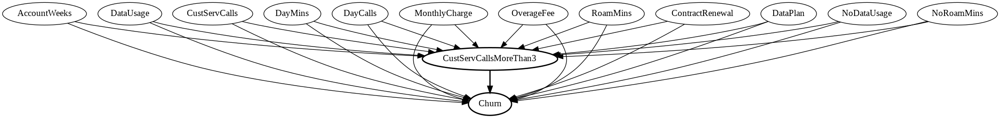

In [ ]:
#@title Графовая модель по умолчанию {display-mode: "form"}
df["CustServCallsMoreThan3"] = (df["CustServCalls"] > 3)

treatment_col = "CustServCallsMoreThan3"

standart_model = CausalModel(
    data=df,
    treatment=treatment_col,
    outcome=TARGET_COL,
    common_causes=[c for c in REAL_COLS + CAT_COLS if c not in (treatment_col, TARGET_COL)],
)

standart_model.view_model()
display(Image(filename="causal_model.png"))

In [ ]:
standart_identified_estimand = standart_model.identify_effect(
    proceed_when_unidentifiable=True
)
print(standart_identified_estimand)

Estimand type: nonparametric-ate

### Estimand : 1
Estimand name: backdoor
Estimand expression:
            d                                                                 
─────────────────────────(Expectation(Churn|OverageFee,CustServCalls,NoRoamMin
d[CustServCallsMoreThan₃]                                                     

                                                                              
s,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,
                                                                              

                         
ContractRenewal,DayMins))
                         
Estimand assumption 1, Unconfoundedness: If U→{CustServCallsMoreThan3} and U→Churn then P(Churn|CustServCallsMoreThan3,OverageFee,CustServCalls,NoRoamMins,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,ContractRenewal,DayMins,U) = P(Churn|CustServCallsMoreThan3,OverageFee,CustServCalls,NoRoamMins,DataUsage,RoamMins,Mont

In [ ]:
standart_estimate = standart_model.estimate_effect(
    standart_identified_estimand,
    method_name="backdoor.propensity_score_matching",
    target_units="ate",
)

print(standart_estimate)

*** Causal Estimate ***

## Identified estimand
Estimand type: nonparametric-ate

### Estimand : 1
Estimand name: backdoor
Estimand expression:
            d                                                                 
─────────────────────────(Expectation(Churn|OverageFee,CustServCalls,NoRoamMin
d[CustServCallsMoreThan₃]                                                     

                                                                              
s,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,
                                                                              

                         
ContractRenewal,DayMins))
                         
Estimand assumption 1, Unconfoundedness: If U→{CustServCallsMoreThan3} and U→Churn then P(Churn|CustServCallsMoreThan3,OverageFee,CustServCalls,NoRoamMins,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,ContractRenewal,DayMins,U) = P(Churn|CustServCallsMoreThan3,OverageFee,

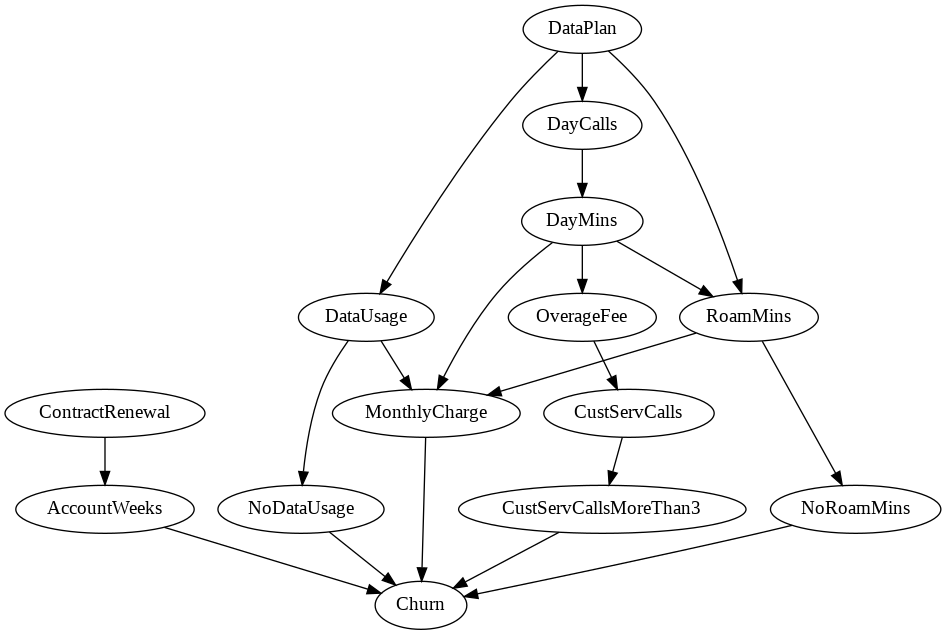

In [ ]:
#@title Графовая модель на основании наших предположений { display-mode: "form" }
causal_graph = """digraph {
Churn[label="Churn"];
AccountWeeks[label="AccountWeeks"];
ContractRenewal[label="ContractRenewal"];
DataPlan[label="DataPlan"];
DataUsage[label="DataUsage"];
CustServCalls[label="CustServCalls"];
DayMins[label="DayMins"];
DayCalls[label="DayCalls"];
MonthlyCharge[label="MonthlyCharge"];
OverageFee[label="OverageFee"];
RoamMins[label="RoamMins"];
NoDataUsage[label="NoDataUsage"];
NoRoamMins[label="NoRoamMins"];
CustServCallsMoreThan3[label="CustServCallsMoreThan3"];
DataPlan -> {DayCalls, DataUsage, RoamMins};
ContractRenewal -> AccountWeeks;
DayCalls -> DayMins;
DayMins -> {OverageFee, RoamMins};
RoamMins -> {NoRoamMins};
DataUsage -> {NoDataUsage};
{OverageFee} -> {CustServCalls};
{DayMins, RoamMins, DataUsage} -> MonthlyCharge;
CustServCalls -> CustServCallsMoreThan3;
{CustServCallsMoreThan3, AccountWeeks, NoRoamMins, NoDataUsage, MonthlyCharge} -> Churn;
}"""

custom_model = dowhy.CausalModel(
    data=df,
    graph=causal_graph.replace("\n", " "),
    treatment=treatment_col,
    outcome=TARGET_COL,
)
custom_model.view_model()
display(Image(filename="causal_model.png"))

In [ ]:
custom_identified_estimand = custom_model.identify_effect(
    proceed_when_unidentifiable=True
)
print(custom_identified_estimand)

Estimand type: nonparametric-ate

### Estimand : 1
Estimand name: backdoor
Estimand expression:
            d                                                                 
─────────────────────────(Expectation(Churn|OverageFee,CustServCalls,NoRoamMin
d[CustServCallsMoreThan₃]                                                     

                                                                              
s,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,
                                                                              

                         
ContractRenewal,DayMins))
                         
Estimand assumption 1, Unconfoundedness: If U→{CustServCallsMoreThan3} and U→Churn then P(Churn|CustServCallsMoreThan3,OverageFee,CustServCalls,NoRoamMins,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,ContractRenewal,DayMins,U) = P(Churn|CustServCallsMoreThan3,OverageFee,CustServCalls,NoRoamMins,DataUsage,RoamMins,Mont

In [ ]:
custom_estimate = custom_model.estimate_effect(
    custom_identified_estimand,
    method_name="backdoor.propensity_score_matching",
    target_units="ate",
)

print(custom_estimate)

*** Causal Estimate ***

## Identified estimand
Estimand type: nonparametric-ate

### Estimand : 1
Estimand name: backdoor
Estimand expression:
            d                                                                 
─────────────────────────(Expectation(Churn|OverageFee,CustServCalls,NoRoamMin
d[CustServCallsMoreThan₃]                                                     

                                                                              
s,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,
                                                                              

                         
ContractRenewal,DayMins))
                         
Estimand assumption 1, Unconfoundedness: If U→{CustServCallsMoreThan3} and U→Churn then P(Churn|CustServCallsMoreThan3,OverageFee,CustServCalls,NoRoamMins,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,ContractRenewal,DayMins,U) = P(Churn|CustServCallsMoreThan3,OverageFee,

Применим **Refutations**, чтобы провалидировать оценённый эффект:
* `random_common_cause` — добавим назвисимую случайную переменную, влияющую на датасет;
* `data_subset_refuter` — оценим эффект на случайном подмножестве нашего датасета;
* `bootstrap_refuter` — оценим эффект на подвыборке методом bootstrap из датасета.

Результат оценки не должен значительно измениться.


In [ ]:
standart_results = {}
custom_results = {}
for method in [
    "placebo_treatment_refuter", 
    "random_common_cause",
    "data_subset_refuter",
]:
    standart_res = standart_model.refute_estimate(
        standart_identified_estimand,
        standart_estimate,
        method_name=method,
        placebo_type="permute",
        subset_fraction=0.8,
    )
    custom_res = custom_model.refute_estimate(
        custom_identified_estimand,
        custom_estimate,
        method_name=method,
        placebo_type="permute",
        subset_fraction=0.8,
    )
    standart_results[method] = (standart_res.estimated_effect, standart_res.new_effect)
    custom_results[method] = (custom_res.estimated_effect, custom_res.new_effect)

In [ ]:
standart_results

{'data_subset_refuter': (-0.0483048304830483, -0.024684921230307574),
 'placebo_treatment_refuter': (-0.0483048304830483, 0.0007110711071107114),
 'random_common_cause': (-0.0483048304830483, -0.052205220522052204)}

In [ ]:
custom_results

{'data_subset_refuter': (-0.0483048304830483, -0.02056264066016504),
 'placebo_treatment_refuter': (-0.0483048304830483, 0.0019501950195019505),
 'random_common_cause': (-0.0483048304830483, -0.05850585058505851)}

**Вывод:** в данном случае оценка по нашей модели ощутимо отличается от модели по умолчанию. При этом оценка предполагает, что периодические звонки в техподдержку скорее показывают нам готовность клиента сотрудничать, чем его желание сменить оператора связи.
Но в процессе refutation мы видим значительные отклонения от начальной оценки, что говорит нам об ошибках в наших предположениях и обобщениях в части выделения признака "количество звонков в подддержку больше трёх" и графовой модели, построенной с учётом этого признака.

## 1.3 Исследование зависимости бинарного признака (месячная оплата находится в верхнем квартиле) на отток
(используем  propensity score weighting для оценки эффекта, проверка refutation проходит корректно)

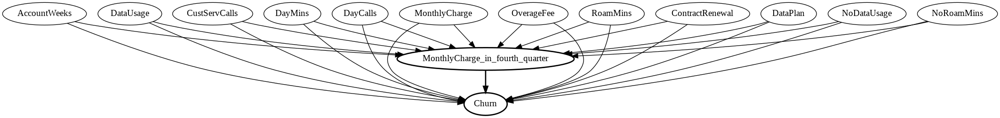

In [ ]:
#@title Графовая модель по умолчанию {display-mode: "form"}
df["MonthlyCharge_in_fourth_quarter"] = (df['MonthlyCharge'] > df['MonthlyCharge'].quantile(0.75))

treatment_col = "MonthlyCharge_in_fourth_quarter"

standart_model = CausalModel(
    data=df,
    treatment=treatment_col,
    outcome=TARGET_COL,
    common_causes=[c for c in REAL_COLS + CAT_COLS if c not in (treatment_col, TARGET_COL)],
)

standart_model.view_model()
display(Image(filename="causal_model.png"))

In [ ]:
standart_identified_estimand = standart_model.identify_effect(
    proceed_when_unidentifiable=True
)
print(standart_identified_estimand)

Estimand type: nonparametric-ate

### Estimand : 1
Estimand name: backdoor
Estimand expression:
                d                                                             
──────────────────────────────────(Expectation(Churn|OverageFee,CustServCalls,
d[MonthlyCharge_in_fourth_quarter]                                            

                                                                              
NoRoamMins,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,
                                                                              

                                  
DayCalls,ContractRenewal,DayMins))
                                  
Estimand assumption 1, Unconfoundedness: If U→{MonthlyCharge_in_fourth_quarter} and U→Churn then P(Churn|MonthlyCharge_in_fourth_quarter,OverageFee,CustServCalls,NoRoamMins,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,ContractRenewal,DayMins,U) = P(Churn|MonthlyCharge_in_fourth_quarter,Overa

In [ ]:
standart_estimate = standart_model.estimate_effect(
    standart_identified_estimand,
    method_name="backdoor.propensity_score_weighting",
    target_units="ate",
)

print(standart_estimate)

*** Causal Estimate ***

## Identified estimand
Estimand type: nonparametric-ate

### Estimand : 1
Estimand name: backdoor
Estimand expression:
                d                                                             
──────────────────────────────────(Expectation(Churn|OverageFee,CustServCalls,
d[MonthlyCharge_in_fourth_quarter]                                            

                                                                              
NoRoamMins,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,
                                                                              

                                  
DayCalls,ContractRenewal,DayMins))
                                  
Estimand assumption 1, Unconfoundedness: If U→{MonthlyCharge_in_fourth_quarter} and U→Churn then P(Churn|MonthlyCharge_in_fourth_quarter,OverageFee,CustServCalls,NoRoamMins,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,ContractRenewal,DayMins,U)

Также попробуем немного изменить наши предположения.

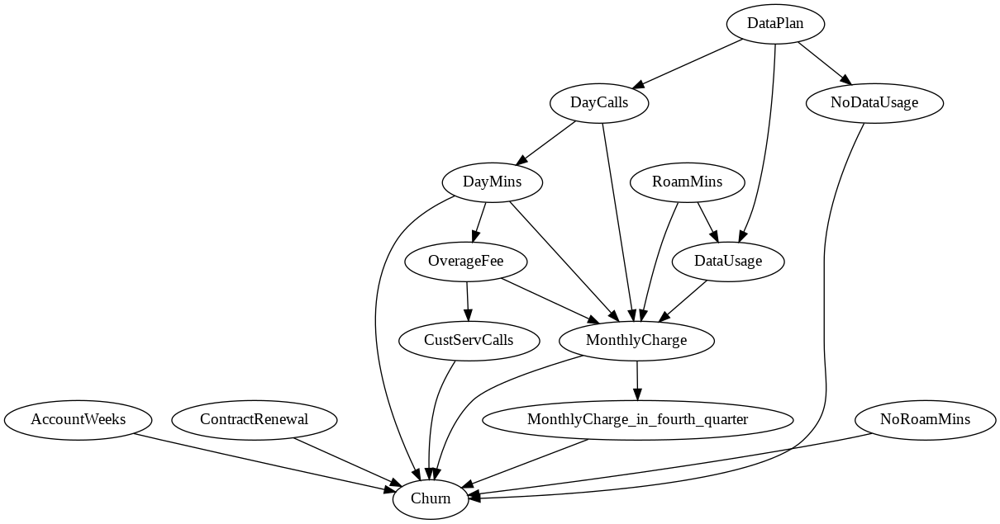

In [ ]:
#@title Графовая модель на основании наших предположений { display-mode: "form" }
causal_graph = """digraph {
Churn[label="Churn"];
AccountWeeks[label="AccountWeeks"];
ContractRenewal[label="ContractRenewal"];
DataPlan[label="DataPlan"];
DataUsage[label="DataUsage"];
CustServCalls[label="CustServCalls"];
DayMins[label="DayMins"];
DayCalls[label="DayCalls"];
MonthlyCharge[label="MonthlyCharge"];
OverageFee[label="OverageFee"];
RoamMins[label="RoamMins"];
NoDataUsage[label="NoDataUsage"];
NoRoamMins[label="NoRoamMins"];
MonthlyCharge_in_fourth_quarter[label = "MonthlyCharge_in_fourth_quarter"]
DataPlan -> {DayCalls, DataUsage, NoDataUsage}; 
DayCalls -> {DayMins, MonthlyCharge};
DayMins -> {OverageFee, MonthlyCharge};
RoamMins -> {MonthlyCharge, DataUsage};
OverageFee -> {CustServCalls, MonthlyCharge};
DataUsage -> MonthlyCharge;
MonthlyCharge -> MonthlyCharge_in_fourth_quarter;
{CustServCalls, AccountWeeks, NoRoamMins, NoDataUsage, MonthlyCharge, DayMins, ContractRenewal, MonthlyCharge_in_fourth_quarter} -> Churn;
}"""

custom_model = dowhy.CausalModel(
    data=df,
    graph=causal_graph.replace("\n", " "),
    treatment=treatment_col,
    outcome=TARGET_COL,
)

custom_model.view_model()
display(Image(filename="causal_model.png"))

In [ ]:
custom_identified_estimand = custom_model.identify_effect(
    proceed_when_unidentifiable=True
)
print(custom_identified_estimand)


Estimand type: nonparametric-ate

### Estimand : 1
Estimand name: backdoor
Estimand expression:
                d                                                             
──────────────────────────────────(Expectation(Churn|OverageFee,CustServCalls,
d[MonthlyCharge_in_fourth_quarter]                                            

                                                                              
NoRoamMins,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,
                                                                              

                                  
DayCalls,ContractRenewal,DayMins))
                                  
Estimand assumption 1, Unconfoundedness: If U→{MonthlyCharge_in_fourth_quarter} and U→Churn then P(Churn|MonthlyCharge_in_fourth_quarter,OverageFee,CustServCalls,NoRoamMins,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,ContractRenewal,DayMins,U) = P(Churn|MonthlyCharge_in_fourth_quarter,Overa

In [ ]:
custom_estimate = custom_model.estimate_effect(
    custom_identified_estimand,
    method_name="backdoor.propensity_score_weighting",
    target_units="ate",
)

print(custom_estimate)

*** Causal Estimate ***

## Identified estimand
Estimand type: nonparametric-ate

### Estimand : 1
Estimand name: backdoor
Estimand expression:
                d                                                             
──────────────────────────────────(Expectation(Churn|OverageFee,CustServCalls,
d[MonthlyCharge_in_fourth_quarter]                                            

                                                                              
NoRoamMins,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,
                                                                              

                                  
DayCalls,ContractRenewal,DayMins))
                                  
Estimand assumption 1, Unconfoundedness: If U→{MonthlyCharge_in_fourth_quarter} and U→Churn then P(Churn|MonthlyCharge_in_fourth_quarter,OverageFee,CustServCalls,NoRoamMins,DataUsage,RoamMins,MonthlyCharge,NoDataUsage,DataPlan,AccountWeeks,DayCalls,ContractRenewal,DayMins,U)

Применим **Refutations**, чтобы провалидировать оценённый эффект:
* `random_common_cause` — добавим назвисимую случайную переменную, влияющую на датасет;
* `data_subset_refuter` — оценим эффект на случайном подмножестве нашего датасета;
* `bootstrap_refuter` — оценим эффект на подвыборке методом bootstrap из датасета.

In [ ]:
standart_results = {}
custom_results = {}
for method in [
    "bootstrap_refuter", 
    "random_common_cause",
    "data_subset_refuter",
]:
    standart_res = standart_model.refute_estimate(
        standart_identified_estimand,
        standart_estimate,
        method_name=method,
        placebo_type="permute",
        subset_fraction=0.8,
    )
    custom_res = custom_model.refute_estimate(
        custom_identified_estimand,
        custom_estimate,
        method_name=method,
        placebo_type="permute",
        subset_fraction=0.8,
    )
    standart_results[method] = (standart_res.estimated_effect, standart_res.new_effect)
    custom_results[method] = (custom_res.estimated_effect, custom_res.new_effect)

In [ ]:
standart_results

{'bootstrap_refuter': (0.08470446635970111, 0.08388406312572574),
 'data_subset_refuter': (0.08470446635970111, 0.08475671749904647),
 'random_common_cause': (0.08470446635970111, 0.09269003163802506)}

In [ ]:
custom_results

{'bootstrap_refuter': (0.08470446635970111, 0.08798673357073916),
 'data_subset_refuter': (0.08470446635970111, 0.08123288454480454),
 'random_common_cause': (0.08470446635970111, 0.08525322157463033)}

**Вывод**: попадание клиента в верхний квартиль по месячной оплате за услуги связи положительно влияет на отток. Но по результатам анализа причинно-следственных связей влияние достаточно незначительное.<br>
Оценка по предложенной модели слабо отличается от модели по умолчанию. Refutation показывает корректность оценки нашей модели.

# 2 Обучение моделей чёрного ящика

Разделим данные на обучающую и тестовую выборки:

In [ ]:
train_X, test_X, train_y, test_y = train_test_split(
    df.drop(columns=[TARGET_COL]),
    df[TARGET_COL],
    test_size=0.2,
    stratify=df[TARGET_COL],
    random_state=42,
)

Применим *Z*-нормализацию к численным данным:

In [ ]:
scaler = StandardScaler()

In [ ]:
scaler.fit(train_X[REAL_COLS])

real_train = scaler.transform(train_X[REAL_COLS])
real_test = scaler.transform(test_X[REAL_COLS])

In [ ]:
train_data = np.hstack([real_train, train_X[CAT_COLS]])
test_data = np.hstack([real_test, test_X[CAT_COLS]])

Создадим инстанс кросс-валидатора:

In [ ]:
cv = StratifiedKFold(n_splits=5, random_state=42, shuffle=True)

## 2.1 Логистическая регрессия

Обучим модель логистической регрессии, подберём гиперпараметры:

In [ ]:
modelLR = LogisticRegression(solver="liblinear", max_iter=200)
param_grid = [{"penalty": ["l1", "l2"], "C": [0.001, 0.01, 0.1, 1, 10, 100]}]
modelGrid = GridSearchCV(modelLR, param_grid[0], scoring="accuracy", cv=cv)
modelGrid.fit(train_data, train_y)
print(modelGrid.best_score_)
print(modelGrid.best_params_)

0.860092332989017
{'C': 0.1, 'penalty': 'l2'}


In [ ]:
lr_model = modelGrid.best_estimator_

## 2.2 Ансамбль деревьев решений

Обучим модель на основе ансамбля деревьев (XGBoost), подберём гиперпараметры:

In [ ]:
modelXGB = XGBClassifier(verbosity=0)
param_grid = [
    {
        "n_estimators": [150, 200, 300],
        "max_depth": [4, 5, 6],
        "learning_rate": [0.1, 0.2, 0.5],
    }
]
modelGrid = GridSearchCV(modelXGB, param_grid[0], scoring="accuracy", cv=cv)
modelGrid.fit(train_data, train_y)
print(modelGrid.best_score_)
print(modelGrid.best_params_)

0.9369873024572943
{'learning_rate': 0.1, 'max_depth': 6, 'n_estimators': 300}


In [ ]:
xgb_model = modelGrid.best_estimator_

## 2.3 Нейронная сеть

Обучим многослойный перцептрон, подберём гиперпараметры:

In [ ]:
modelMLP = MLPClassifier(max_iter=50)
param_grid = [
    {
        "hidden_layer_sizes": [(32, 64, 32), (64, 128, 64)],
        "activation": ["relu"],
        "solver": ["sgd", "adam"],
        "alpha": [0.05, 0.001],
        "learning_rate": ["constant"],
    }
]
modelGrid = GridSearchCV(modelMLP, param_grid[0], scoring="accuracy", cv=cv)
modelGrid.fit(train_data, train_y)
print(modelGrid.best_score_)
print(modelGrid.best_params_)

0.9234872919169987
{'activation': 'relu', 'alpha': 0.001, 'hidden_layer_sizes': (32, 64, 32), 'learning_rate': 'constant', 'solver': 'adam'}


In [ ]:
mlp_model = modelGrid.best_estimator_

## 2.4 Выбор лучшей модели

In [ ]:
xgb_model.fit(train_data, train_y)
lr_model.fit(train_data, train_y)
mlp_model.fit(train_data, train_y)

MLPClassifier(alpha=0.001, hidden_layer_sizes=(32, 64, 32), max_iter=50)

In [ ]:
models = {"xgb": xgb_model, "lr": lr_model, "mlp": mlp_model}

In [ ]:
best_model = None
best_score = 0
for name, model in models.items():
    prediction = model.predict(test_data)
    score = accuracy_score(test_y, prediction)
    if score > best_score:
        best_score = score
        best_model = name

In [ ]:
best_model

'xgb'

# 3 Применение SHAP

## 3.1 Сравнение важности признаков, получаемой с помощью SHAP и с помощью ансамбля деревьев решений

In [ ]:
feature_names = np.array(REAL_COLS + CAT_COLS)

In [ ]:
xgb_feature_importances = models["xgb"].feature_importances_

In [ ]:
sorted_fi = np.argsort(xgb_feature_importances)[::-1]

Важность признаков, получаемая с помощью модели на основе ансамбля деревьев решений:

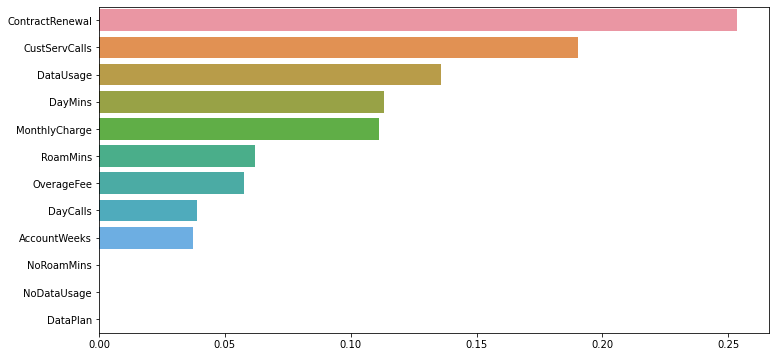

In [ ]:
plt.figure(figsize=(12, 6))
sns.barplot(xgb_feature_importances[sorted_fi],
            feature_names[sorted_fi],
            orient="h");

Важность признаков, получаемая на основе SHAP:

In [ ]:
explainer = shap.Explainer(models["xgb"], train_data,
                           feature_names=feature_names)

 97%|=================== | 2597/2666 [00:27<00:00]       

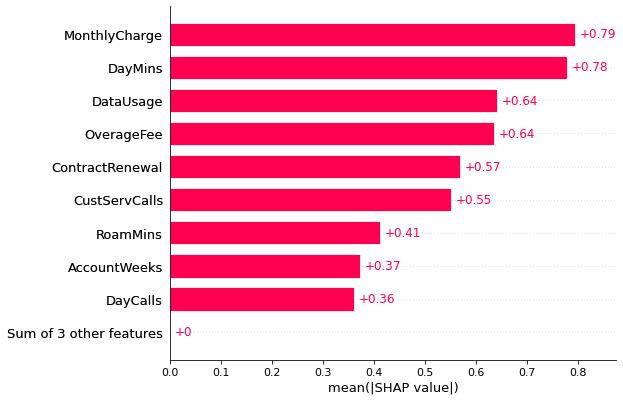

In [ ]:
shap_values = explainer(train_data)
shap.plots.bar(shap_values)

Как видно из диаграмм, важность признаков, получаемая с помощью SHAP, и важность признаков, получаемая с помощью модели на основе ансамбля деревьев решений, отличаются. Это можно объяснить тем, что в модели на основе ансамбля деревьев решений важность признака основана на количестве использований этого признака в узлах деревьев, в то время как в SHAP важность основана на изменении предсказаний при изменении значения признака.

## 3.2 Анализ всего набора данных и данных по классам

In [ ]:
explainer = shap.Explainer(models[best_model],
                           test_data,
                           feature_names=feature_names)

Важность признаков, получаемая с помощью SHAP, для всего набора данных:

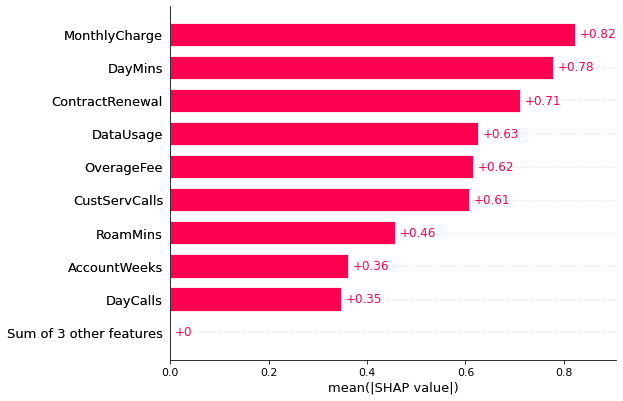

In [ ]:
shap_values = explainer(test_data, check_additivity=False)
shap.plots.bar(shap_values)

Важность признаков, получаемая с помощью SHAP, для наблюдений с положительным классом:

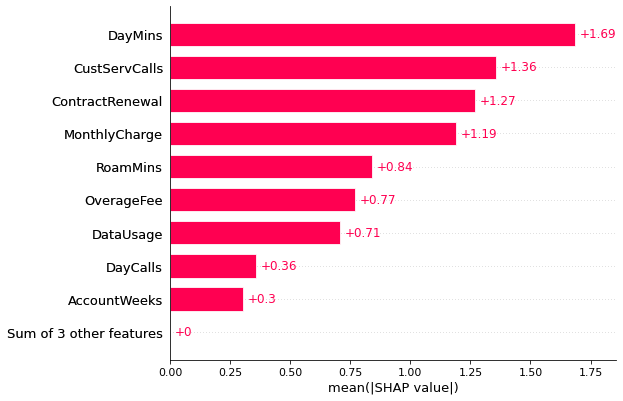

In [ ]:
shap_values = explainer(test_data[test_y == 1], check_additivity=False)
shap.plots.bar(shap_values)

Важность признаков, получаемая с помощью SHAP, для наблюдений с отрицательным классом:

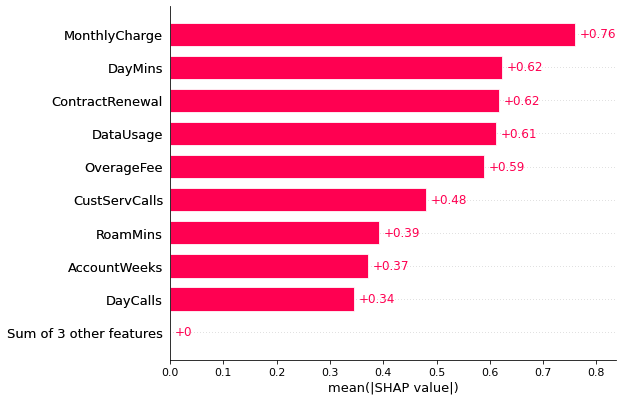

In [ ]:
shap_values = explainer(test_data[test_y == 0], check_additivity=False)
shap.plots.bar(shap_values)

Как видно из диаграмм, важность признаков для всего набора данных и между классами меняется несущественно: наиболее важными признаками являются ежемесячная плата, количество потраченных за день минут, продление договора, плата за превышение тарифных лимитов и объём потреблённого трафика.

Для наблюдений с оттоком клиентов дополнительную важность имеют число звонков в техподдержку и количество минут в роуминге.

## 3.3 Анализ отдельных примеров

### Выбор примеров для анализа

In [ ]:
proba_prediction = models[best_model].predict_proba(test_data)[:, 1]
prediction = (proba_prediction > 0.5).astype(np.uint8)

right_pos_pred_idx = np.where((prediction == test_y) & (test_y == 1))[0]
right_pos_probas = proba_prediction[right_pos_pred_idx]

right_neg_pred_idx = np.where((prediction == test_y) & (test_y == 0))[0]
right_neg_probas = proba_prediction[right_neg_pred_idx]

wrong_pos_pred_idx = np.where((prediction != test_y) & (test_y == 1))[0]
wrong_pos_probas = proba_prediction[wrong_pos_pred_idx]

wrong_neg_pred_idx = np.where((prediction != test_y) & (test_y == 0))[0]
wrong_neg_probas = proba_prediction[wrong_neg_pred_idx]

prediction_dict = {
    "best_pos": right_pos_pred_idx[np.argmax(right_pos_probas)],
    "best_neg": right_neg_pred_idx[np.argmin(right_neg_probas)],
    "worst_pos": wrong_pos_pred_idx[np.argmin(wrong_pos_probas)],
    "worst_neg": wrong_neg_pred_idx[np.argmax(wrong_neg_probas)],
}

`best_pos` и `best_neg` соответствуют правильно классифицированным примерам, принадлежащим к разным классам, `worst_pos` и `worst_neg` — неправильно классифицированным.

In [ ]:
def explain_with_shap(explainer, experiment_name: str,
                      experiment_predictions: dict,
                      data, feature_names):
    idx = experiment_predictions[experiment_name]
    shap_values = explainer.shap_values(data[idx].reshape(1, -1))
    shap.initjs()
    return shap.force_plot(
        explainer.expected_value,
        shap_values[0],
        data[idx],
        feature_names=feature_names
    )

In [ ]:
def explain_with_shap_kernel(explainer, experiment_name: str,
                             experiment_predictions: dict,
                             data, feature_names):
    idx = experiment_predictions[experiment_name]
    shap_values = explainer.shap_values(data[idx].reshape(1, -1))[0]
    shap.initjs()
    return shap.force_plot(
        explainer.expected_value[0],
        shap_values[0],
        data[idx],
        feature_names=feature_names
    )

### 3.3.1 Первый пример

In [ ]:
experiment_name = "best_pos"

Анализ предсказаний модели на основе линейной регрессии:

In [ ]:
explainer = shap.LinearExplainer(models["lr"], train_data)
explain_with_shap(explainer, experiment_name, prediction_dict,
                  test_data, feature_names)

Анализ предсказаний модели на основе ансамбля деревьев решений:

In [ ]:
explainer = shap.TreeExplainer(models["xgb"], train_data)
explain_with_shap(explainer, experiment_name, prediction_dict,
                  test_data, feature_names)

Анализ предсказаний модели на основе нейронной сети:

In [ ]:
explainer = shap.KernelExplainer(models["mlp"].predict_proba, train_data)
explain_with_shap_kernel(explainer, experiment_name, prediction_dict,
                         test_data, feature_names)

Using 2666 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


  0%|          | 0/1 [00:00<?, ?it/s]

Из диаграмм для этого примера видно, что в тех случаях, когда предсказания моделей совпадают, наибольший вклад вносит один и тот же признак.

### 3.3.2 Второй пример

In [ ]:
experiment_name = "best_neg"

Анализ предсказаний модели на основе линейной регрессии:

In [ ]:
explainer = shap.LinearExplainer(models["lr"], train_data)
explain_with_shap(explainer, experiment_name, prediction_dict,
                  test_data, feature_names)

Анализ предсказаний модели на основе ансамбля деревьев решений:

In [ ]:
explainer = shap.TreeExplainer(models["xgb"], train_data)
explain_with_shap(explainer, experiment_name, prediction_dict,
                  test_data, feature_names)

Анализ предсказаний модели на основе нейронной сети:

In [ ]:
explainer = shap.KernelExplainer(models["mlp"].predict_proba, train_data)
explain_with_shap_kernel(explainer, experiment_name, prediction_dict,
                         test_data, feature_names)

Using 2666 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


  0%|          | 0/1 [00:00<?, ?it/s]

В данном примере важности признаков моделей отличаются кардинальным образом.

### 3.3.3 Третий пример

In [ ]:
experiment_name = "worst_pos"

Анализ предсказаний модели на основе линейной регрессии:

In [ ]:
explainer = shap.LinearExplainer(models["lr"], train_data)
explain_with_shap(explainer, experiment_name, prediction_dict,
                  test_data, feature_names)

Анализ предсказаний модели на основе ансамбля деревьев решений:

In [ ]:
explainer = shap.TreeExplainer(models["xgb"], train_data)
explain_with_shap(explainer, experiment_name, prediction_dict,
                  test_data, feature_names)

Анализ предсказаний модели на основе нейронной сети:

In [ ]:
explainer = shap.KernelExplainer(models["mlp"].predict_proba, train_data)
explain_with_shap_kernel(explainer, experiment_name, prediction_dict,
                         test_data, feature_names)

Using 2666 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


  0%|          | 0/1 [00:00<?, ?it/s]

В данном примере признаки с наибольшим вкладом для первых двух моделей сильно пересекаются, в то время как для модели на основе нейронной сети отличны и решение модели, и важные признаки.

### 3.3.4 Четвёртый пример

In [ ]:
experiment_name = "worst_neg"

Анализ предсказаний модели на основе линейной регрессии:

In [ ]:
explainer = shap.LinearExplainer(models["lr"], train_data)
explain_with_shap(explainer, experiment_name, prediction_dict,
                  test_data, feature_names)

Анализ предсказаний модели на основе ансамбля деревьев решений:

In [ ]:
explainer = shap.TreeExplainer(models["xgb"], train_data)
explain_with_shap(explainer, experiment_name, prediction_dict,
                  test_data, feature_names)

Анализ предсказаний модели на основе нейронной сети:

In [ ]:
explainer = shap.KernelExplainer(models["mlp"].predict_proba, train_data)
explain_with_shap_kernel(explainer, experiment_name, prediction_dict,
                         test_data, feature_names)

Using 2666 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


  0%|          | 0/1 [00:00<?, ?it/s]

И предсказания, и важности признаков всех трёх моделей в этом примере значительно отличаются друг от друга.

# 4 Применение LIME

In [ ]:
def explain_with_lime(explainer, model, index: int,
                      data, feature_names) -> None:
    explanation = explainer.explain_instance(
        data[index],
        lambda x: model.predict_proba(x),
        num_features=len(feature_names),
    )
    explanation.show_in_notebook(show_all=False)

In [ ]:
explainer = lime.lime_tabular.LimeTabularExplainer(
    train_data, feature_names=feature_names
)

## 4.1 Первый пример

In [ ]:
experiment_name = "best_pos"

In [ ]:
explain_with_lime(explainer, models["lr"], prediction_dict[experiment_name],
                  test_data, feature_names)

In [ ]:
explain_with_lime(explainer, models["xgb"], prediction_dict[experiment_name],
                  test_data, feature_names)

In [ ]:
explain_with_lime(explainer, models["mlp"], prediction_dict[experiment_name],
                  test_data, feature_names)

В первом примере для всех трёх моделей наиболее важным оказывается один и тот же признак — количество звонков в техподдержку.

## 4.2 Второй пример

In [ ]:
experiment_name = "best_neg"

In [ ]:
explain_with_lime(explainer, models["lr"], prediction_dict[experiment_name],
                  test_data, feature_names)

In [ ]:
explain_with_lime(explainer, models["xgb"], prediction_dict[experiment_name],
                  test_data, feature_names)

In [ ]:
explain_with_lime(explainer, models["mlp"], prediction_dict[experiment_name],
                  test_data, feature_names)

Во втором примере количество звонков в техподдержку по-прежнему является самым важным признаком для моделей линейной регрессии и ансамбля деревьев, а вот для модели на основе нейронных сетей важность признаков довольно значительно меняется.

## 4.3 Третий пример

In [ ]:
experiment_name = "worst_pos"

In [ ]:
explain_with_lime(explainer, models["lr"], prediction_dict[experiment_name],
                  test_data, feature_names)

In [ ]:
explain_with_lime(explainer, models["xgb"], prediction_dict[experiment_name],
                  test_data, feature_names)

In [ ]:
explain_with_lime(explainer, models["mlp"], prediction_dict[experiment_name],
                  test_data, feature_names)

Во третьем примере количество звонков в техподдержку по-прежнему является самым важным признаком для моделей линейной регрессии и ансамбля деревьев, а вот для модели на основе нейронных сетей важность признаков довольно значительно меняется.

## 4.4 Четвёртый пример

In [ ]:
experiment_name = "worst_neg"

In [ ]:
explain_with_lime(explainer, models["lr"], prediction_dict[experiment_name],
                  test_data, feature_names)

In [ ]:
explain_with_lime(explainer, models["xgb"], prediction_dict[experiment_name],
                  test_data, feature_names)

In [ ]:
explain_with_lime(explainer, models["mlp"], prediction_dict[experiment_name],
                  test_data, feature_names)

В четвёртом примере число звонков в техподдержку становится самым важным признаком для всех трёх моделей.

# 5 Выводы

Согласно результатам применения методов SHAP и LIME, число обращений в техподдержку действительно является одним из важных (если не самым важным) признаком при прогнозировании оттока пользователей.

Кроме того, объяснения, полученные с помощью метода LIME, выглядят более стабильными и поэтому более интерпретируемыми.